In [1]:
import pandas as pd
import numpy as np
import anndata as ad
from random import sample
from math import ceil
from sklearn.preprocessing import minmax_scale
import matplotlib.pyplot as plt
from SpatialDE import spatial_patterns, SpatialPatternParameters

In [2]:
filename = "/nfs/leia/research/stegle/acuomo/singlecell_endodiff/data/pipeline_snakemakes/output_structlmm_alldays_10PCs/eqtl_tot_genetic_effect_all.txt"
df = pd.read_csv(filename, sep = "\t", index_col=0)
df.head()

,ENSG00000176125_UFSP1-7_100492322_C_T,ENSG00000175106_TVP23C-17_15478507_G_C,ENSG00000147677_EIF3H-8_117688031_G_A,ENSG00000204389_HSPA1A-6_31761865_T_C,ENSG00000204389_HSPA1A-6_31785228_G_C,ENSG00000116731_PRDM2-1_14235022_G_A,ENSG00000203485_INF2-14_105216381_C_T,ENSG00000091317_CMTM6-3_32523777_T_C,ENSG00000126524_SBDS-7_66440718_A_G,ENSG00000144134_RABL2A-2_114406459_G_A,...,ENSG00000206535_LNP1-3_100055273_G_A,ENSG00000206535_LNP1-3_100060779_C_T,ENSG00000206535_LNP1-3_100181999_G_T,ENSG00000143971_ETAA1-2_67712034_T_G,ENSG00000054277_OPN3-1_241892235_T_C,ENSG00000069667_RORA-15_61467734_T_C,ENSG00000173894_CBX2-17_77814533_G_A,ENSG00000164930_FZD6-8_104312432_A_G,ENSG00000164930_FZD6-8_104317011_A_G,ENSG00000164930_FZD6-8_104345778_A_G
21843_1#99,-0.092291,-0.020901,-0.054118,-0.617919,-0.654549,-0.013270,-0.185045,0.150489,-0.064830,0.041793,...,-0.039099,-0.142666,-0.091894,-0.094953,-0.080701,-0.067996,0.026881,-0.202234,-0.197769,-0.203371
24229_5#47,-0.094179,-0.418200,0.039307,-1.340217,-1.205610,-0.028206,-0.306860,0.050959,-0.089726,0.208231,...,-0.061028,-0.100131,-0.267392,-0.111616,-0.015448,-0.110905,0.030413,-0.006998,0.006067,-0.068799
25535_2#136,-0.080449,-0.044425,-0.047899,-0.879945,-0.889774,0.008512,-0.163487,0.146643,-0.030945,0.042243,...,-0.106094,-0.148331,-0.133007,-0.088487,-0.088059,-0.050601,0.009392,-0.249793,-0.244262,-0.224866
23794_1#233,-0.091711,-0.042417,-0.120662,-0.429285,-0.449291,-0.049670,-0.173315,0.185699,-0.005271,0.036158,...,-0.139418,-0.191834,-0.090162,-0.129926,-0.137495,-0.043284,0.043521,-0.317619,-0.326827,-0.264026
25475_3#27,-0.089183,-0.029810,-0.100041,-0.405588,-0.401307,-0.033448,-0.225870,0.170078,-0.069707,0.007676,...,-0.225352,-0.196503,-0.158505,-0.112523,-0.072948,-0.041999,0.088213,-0.265396,-0.300596,-0.242712


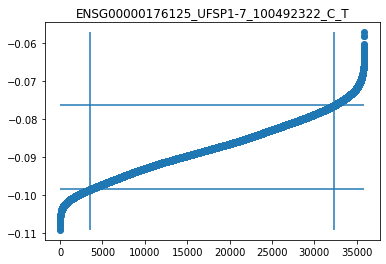

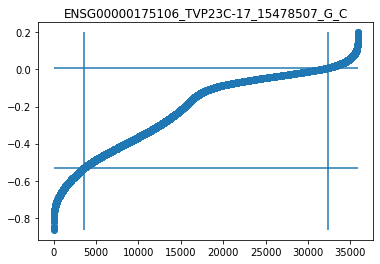

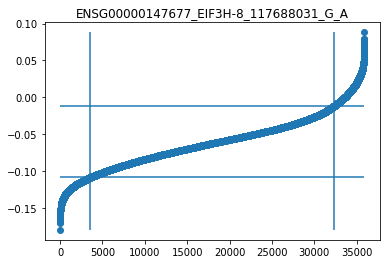

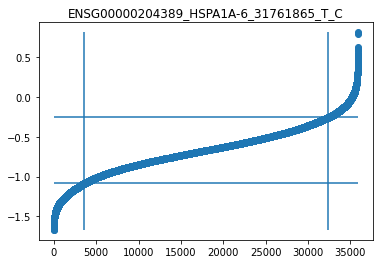

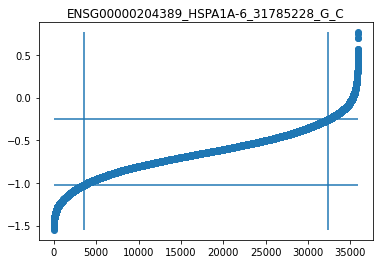

...

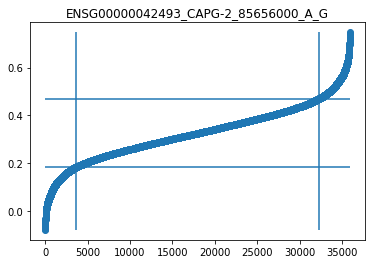

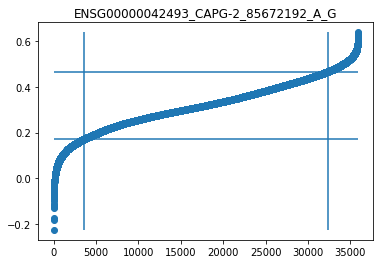

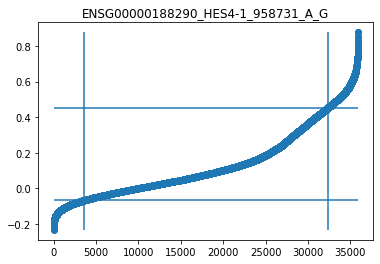

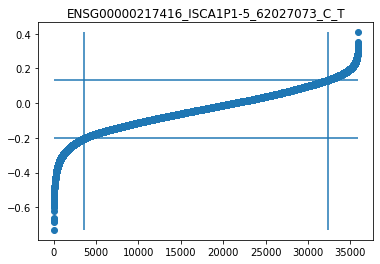

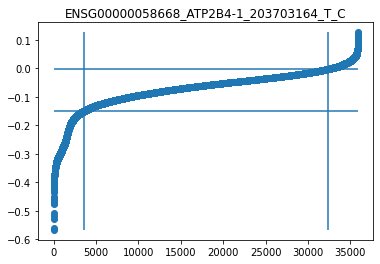

In [53]:
beta = np.array([])
for i in range(df.shape[1]):
    # get single-cell effect sizes
    v = df.values[:,i]
    # get min and max
    ymin = min(v)
    ymax = max(v)
    # rank values
    order = v.argsort()
    y = v[order]
    x = range(len(v))
    plt.scatter(x,y)
    # define 10% of cells
    xx = ceil(0.1*len(v))
    plt.vlines(x=xx,ymin=ymin, ymax=ymax)
    plt.hlines(y=y[xx],xmin=0, xmax=len(v))
    plt.vlines(x=len(v)-xx,ymin=ymin, ymax=ymax)
    plt.hlines(y=y[len(v)-xx],xmin=0, xmax=len(v))
    # add title
    plt.title(df.columns.values[i])
    plt.show()
    beta = np.append(beta,y[len(v)-xx]-y[xx])

In [68]:
beta.shape
df.columns.values.shape

(4062,)

In [69]:
d = np.concatenate([beta.reshape(beta.shape[0],1),df.columns.values.reshape(beta.shape[0],1)], axis=1)
df_beta = pd.DataFrame(data = d, columns = ["beta","eqtl"])
df_beta.head()

,beta,eqtl
0,0.022149,ENSG00000176125_UFSP1-7_100492322_C_T
1,0.538911,ENSG00000175106_TVP23C-17_15478507_G_C
2,0.096656,ENSG00000147677_EIF3H-8_117688031_G_A
3,0.828349,ENSG00000204389_HSPA1A-6_31761865_T_C
4,0.763409,ENSG00000204389_HSPA1A-6_31785228_G_C


In [73]:
df_beta[df_beta["beta"]>4]

,beta,eqtl
1925,4.006901,ENSG00000204531_POU5F1-6_31128552_A_C
1926,4.00007,ENSG00000204531_POU5F1-6_31132414_G_A
2049,4.589649,ENSG00000137331_IER3-6_30639412_A_G
2050,4.257056,ENSG00000137331_IER3-6_30769478_T_C


In [58]:
max(beta)

4.589648667391924

In [65]:
len(beta[beta>0.3])

941

In [62]:
plt.hist(beta[beta>0.5])
plt.show()

In [59]:
beta[beta.argsort()]

array([0.        , 0.        , 0.        , ..., 4.00690118, 4.25705573,
       4.58964867])

In [131]:
### select eQTL based on biggest difference in effect sizes

In [132]:
# diffs = [max(df.values[:,i])-min(df.values[:,i]) for i in range(df.shape[1])]
diffs = np.array(diffs)
len(diffs)

4062

In [133]:
d = np.concatenate((diffs.reshape(len(diffs),1),
                df.columns.values.reshape(df.shape[1],1)), axis=1)

In [134]:
df_betas = pd.DataFrame(data = d, index = df.columns, columns = ["diff","eqtl"])
df_betas.head()

,diff,eqtl
ENSG00000176125_UFSP1-7_100492322_C_T,0.052187,ENSG00000176125_UFSP1-7_100492322_C_T
ENSG00000175106_TVP23C-17_15478507_G_C,1.065997,ENSG00000175106_TVP23C-17_15478507_G_C
ENSG00000147677_EIF3H-8_117688031_G_A,0.268237,ENSG00000147677_EIF3H-8_117688031_G_A
ENSG00000204389_HSPA1A-6_31761865_T_C,2.482953,ENSG00000204389_HSPA1A-6_31761865_T_C
ENSG00000204389_HSPA1A-6_31785228_G_C,2.315302,ENSG00000204389_HSPA1A-6_31785228_G_C


In [135]:
df_betas_sel = df_betas[df_betas["diff"] > 1]
df_betas_sel.head()

,diff,eqtl
ENSG00000175106_TVP23C-17_15478507_G_C,1.065997,ENSG00000175106_TVP23C-17_15478507_G_C
ENSG00000204389_HSPA1A-6_31761865_T_C,2.482953,ENSG00000204389_HSPA1A-6_31761865_T_C
ENSG00000204389_HSPA1A-6_31785228_G_C,2.315302,ENSG00000204389_HSPA1A-6_31785228_G_C
ENSG00000180573_HIST1H2AC-6_26106237_G_T,3.929159,ENSG00000180573_HIST1H2AC-6_26106237_G_T
ENSG00000137563_GGH-8_64036389_T_A,1.151575,ENSG00000137563_GGH-8_64036389_T_A


In [136]:
eqtls = np.array(df_betas_sel["eqtl"])
# eqtls

In [137]:
df = df.loc[:,eqtls]
df.shape

(35916, 773)

In [138]:
### PC coordinates
pcs_filename = "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_endodiff/10pcs_500hvgs.csv"
df_pcs = pd.read_csv(pcs_filename, index_col=0)
df_pcs.head()
df_pcs.index

Index(['21843_1#10', '21843_1#100', '21843_1#101', '21843_1#102',
       '21843_1#103', '21843_1#105', '21843_1#106', '21843_1#107',
       '21843_1#108', '21843_1#109',
       ...
       '24539_8#88', '24539_8#89', '24539_8#90', '24539_8#91', '24539_8#92',
       '24539_8#93', '24539_8#94', '24539_8#95', '24539_8#97', '24539_8#98'],
      dtype='object', length=36044)

In [139]:
## consider only shared cells

In [140]:
all_cells = df_pcs.index.values

In [141]:
## sample 20% of cells

In [142]:
cells = sample(list(all_cells), k = ceil(len(all_cells)*0.2))
cells = sorted(set(list(df.index.values)).intersection(cells))

In [143]:
df = df[df.index.isin(cells)]
df.shape

(6689, 773)

In [144]:
df_pcs = df_pcs[df_pcs.index.isin(cells)]
df_pcs.shape

(6689, 10)

In [145]:
# sort to ensure cells are in the same order
df = df.sort_index(axis=0)
df_pcs = df_pcs.sort_index(axis=0)

In [146]:
# scale values
mat = minmax_scale(df)
df = pd.DataFrame(data = mat, index = df.index, columns = df.columns)

In [147]:
# delect columns that are only 0s
df = df.loc[:, (df != 0).any(axis=0)]

In [148]:
### build "fake" AnnData file
#
# counts: single-cell eQTL effects
# adata.obsm['spatial']: coordinates (PCA, UMAP..)

In [149]:
# obs i.e. cells
obs_names = df.index.values
obs = pd.DataFrame(index=obs_names)
# obs
n_obs = len(obs)
n_obs

6689

In [150]:
# vars i.e. genes (or in this case gene-SNP pairs)
var_names = df.columns.values
var = pd.DataFrame(index=var_names)
# var
n_vars = len(var)
n_vars

773

In [151]:
X = df.to_numpy()
X.shape
type(X)

numpy.ndarray

In [152]:
adata = ad.AnnData(X=X, obs=obs, var=var, dtype='float')
adata

AnnData object with n_obs × n_vars = 6689 × 773

In [153]:
## add PCs as "spatial" coordinates
adata.obsm['spatial'] = df_pcs
adata.obsm['spatial'].shape

(6689, 10)

In [154]:
adata

AnnData object with n_obs × n_vars = 6689 × 773
    obsm: 'spatial'

In [155]:
sp = spatial_patterns(adata, normalized = True, params=SpatialPatternParameters(lengthscales=5))

In [156]:
d = np.concatenate([sp[0].labels.reshape(len(sp[0].labels),1),
                    adata.var.index.to_numpy().reshape(len(sp[0].labels),1)], axis=1)
df_labels = pd.DataFrame(data = d, columns = ["label","gene"])
df_labels.head()

,label,gene
0,12,ENSG00000175106_TVP23C-17_15478507_G_C
1,12,ENSG00000204389_HSPA1A-6_31761865_T_C
2,25,ENSG00000204389_HSPA1A-6_31785228_G_C
3,16,ENSG00000180573_HIST1H2AC-6_26106237_G_T
4,22,ENSG00000137563_GGH-8_64036389_T_A


In [157]:
df_pp = pd.DataFrame(data = sp[0].pattern_probabilities, columns = ["pp"+str(i) for i in np.arange(len(np.unique(sp[0].labels)))])
df_pp.head()

,pp0,pp1,pp2,pp3,pp4,pp5,pp6,pp7,pp8,pp9,...,pp16,pp17,pp18,pp19,pp20,pp21,pp22,pp23,pp24,pp25
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [158]:
df_clusters = pd.concat([df_labels, df_pp], axis = 1)
df_clusters.head()

,label,gene,pp0,pp1,pp2,pp3,pp4,pp5,pp6,pp7,...,pp16,pp17,pp18,pp19,pp20,pp21,pp22,pp23,pp24,pp25
0,12,ENSG00000175106_TVP23C-17_15478507_G_C,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,12,ENSG00000204389_HSPA1A-6_31761865_T_C,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,25,ENSG00000204389_HSPA1A-6_31785228_G_C,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,16,ENSG00000180573_HIST1H2AC-6_26106237_G_T,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,22,ENSG00000137563_GGH-8_64036389_T_A,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [74]:
df_clusters[df_clusters["gene"]=="ENSG00000137331_IER3-6_30639412_A_G"]

NameError: name 'df_clusters' is not defined

In [159]:
for i in np.arange(sp[0].patterns.shape[1]):
    plt.scatter(df_pcs.values[:,0],df_pcs.values[:,1], c = sp[0].patterns[:,i])
    plt.title("cluster "+str(i)+", n="+str(df_clusters[df_clusters["label"] == i].shape[0]))
    plt.show()